# **Title: Crowd Estimation using Autoencoder**

##### Module : CT100-3-M-DL (Deep Learning)
##### Name : Esther Low Jie Ming 
##### TPID : TP062315




## **Introduction**
 


Crowd estimation is a technique to count or estimate the number of people in an area. It can be used in various scenarios such as monitoring traffic, ensuring public safety and many more. It is even more so important now where social distancing should be practiced to prevent further spread of the Covid-19 virus. Throughout the years many different techniques have been researched and developed for crowd estimation. Due to the accessibility to better machines and gadgets most current work on crowd estimation is focused on using deep learning methods. Additionally, as most crowd estimation applications are most likely to be used in uncontrolled conditions, deep learning models are most suitable and able to handle conditions with high variability. 




Among the different types of deep learning techniques that are often used in crowd estimation, variations of Convolutional Neural Network (CNN) are most popular among researchers due to it's ability to learn and extract deep features that even the human eyes cannot see. In this assignment we will be focusing on a Deep CNN Autoencoder which is an autoencoder with convolutional layers instead of neural layers. Moreover, this assignment will focus on the affect of different learning rates on the performance of the model.  

## **Aim**

The main goal of this assignment is to develop a Deep CNN Autoencoder that can make good estimation in sparse or averagely dense crowds. Additionally, the purpose of this assignment is to gain deeper understanding about Deep CNN Autoencoder which can be applied to various fields in future works. Moreover, this assignment aims to experiment with different learning rates to understand the impact on model performance and find the optimal value yielding the best performance.


## **Objective**

* To develop a Deep CNN Autoencoder for crowd estimation 
* To gain deeper understanding about the model architecture of the Deep CNN Autoencoder
* To identify the impact of different learning rate on model 

## **Scope**

This assignment focuses on applying Deep CNN Autoencoder to estimate the number of people in a crowd. In many current research work, most models can only tackle either sparse or highly dense crowds due to the vast difference in challenges faced by both types of crowd. Due to the current pandemic most activities involving highly dense crowds such as a concerts or festive parades are not allowed. Thus, we will be designing and tuning our model to better detect sparse crowds which can be more applicable in most current scenarios.

## **Dataset**

In this project we will be using the ShanghaiTech Part B dataset which contains a collection 716 sparsely distributed crowds. The dataset comes with an original image along with the ground truth which contains all the coordinates of the head in each images. The dataset is originally split into a training set which contains 400 instances and a testing set which contains 316 instances. All images in this dataset are captured in RGB and have varying sizes.



In [ ]:
# link to the dataset folder in my drive 
https://drive.google.com/drive/folders/120OSZoyk_T3A_gtWPkWDcbwjmBKhstsJ?usp=sharing

## **Importing relevant libraries**

In [ ]:
import os
import cv2
import glob
import h5py
import scipy.io as io
import scipy
from scipy.ndimage.filters import gaussian_filter
from scipy import spatial
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib import cm as CM
import PIL.Image as im
import numpy as np
import json
from tkinter import Tcl
from sklearn.model_selection import train_test_split

# libraries used to create the model 
import keras
from tensorflow.keras.layers import BatchNormalization
from keras.preprocessing.image import load_img,img_to_array
from sklearn.metrics import mean_squared_error
from keras.initializers import RandomNormal
from keras.applications.vgg16 import VGG16
from keras import optimizers
from tensorflow.keras.optimizers import SGD, RMSprop
from keras.models import Model,Sequential
from keras.layers import *
from keras import backend as K
from keras.models import load_model
import tensorflow as tf
import PIL
import random
import math
import sys
from keras.utils.vis_utils import plot_model
from tensorflow.keras.optimizers import Adam


## **1. Data Exploration**

In this segment we will explore both the images and also the ground truth within the dataset. 

### 1.1 Example of training images

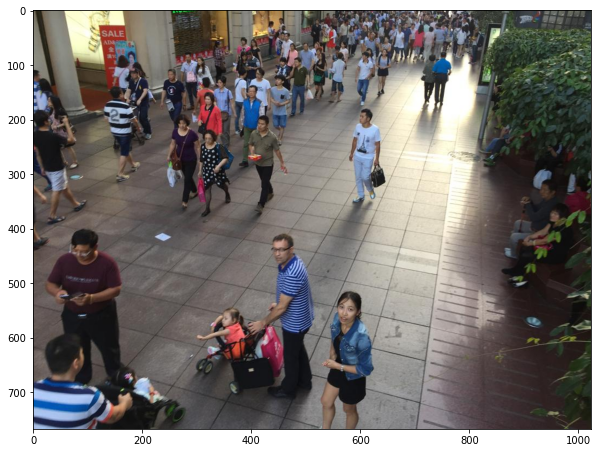

In [ ]:
ex_img_path='/content/drive/MyDrive/Colab Notebooks/DL_Assignment/Shanghai_dataset/part_B_final/train_data/images/IMG_23.jpg'
ex_img = cv2.cvtColor(cv2.imread(ex_img_path),cv2.COLOR_BGR2RGB)
figure = plt.figure(figsize=(10,10))
plt.imshow(ex_img)

In [ ]:
np.shape(ex_img)

(768, 1024, 3)

### 1.2 Example of ground truth

The ground truth is in a form of a dictionary

In [ ]:
ex_mat_path='/content/drive/MyDrive/Colab Notebooks/DL_Assignment/Shanghai_dataset/part_B_final/train_data/ground_truth/GT_IMG_23.mat'
ex_load_mat = io.loadmat(ex_mat_path)
print(type(ex_load_mat))

<class 'dict'>


The dictionary consists of 4 keys as seen below but our main focus would be 'image_info' as it consist the coordinates of the ground truth. 

In [ ]:
print(ex_load_mat.keys())

dict_keys(['__header__', '__version__', '__globals__', 'image_info'])


If we look into the coordinations, we can see that it is in a form of numpy arrays

In [ ]:
print(type(ex_load_mat.get("image_info")))

<class 'numpy.ndarray'>


Extracting the coordinates only from the image_info 

In [ ]:
ex_image_info = ex_load_mat.get("image_info")
ex_coordinates = ex_image_info[0][0][0][0][0]

The shape of the coordinates can tell us the number of people counted in the image.  

In [ ]:
ex_coordinates.shape

(154, 2)

### 1.3 Visualization of annotated coordinates/points on the original image

Here we plot the annoted points from the ground truth onto the original image to showcase it's positions

Text(0.5, 1.0, 'Visualization of annotated points on original image')

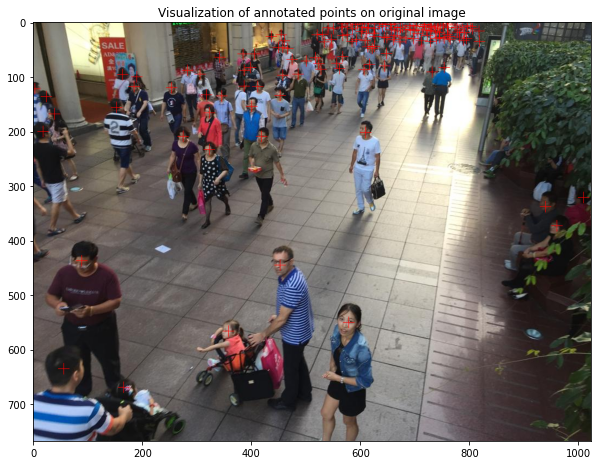

In [ ]:
figure = plt.figure(figsize= (10,10))

for ex_x_coordinate, ex_y_coordinate in ex_coordinates:
  ex_x_coordinate = int(ex_x_coordinate)
  ex_y_coordinate = int(ex_y_coordinate)
  cv2.drawMarker(ex_img, (ex_x_coordinate,ex_y_coordinate), (255,0,0), thickness = 1)

plt.imshow(ex_img)
plt.title("Visualization of annotated points on original image")


### 1.4 Visualization of annotated points/coordinated without original image

Although the image looks like a blank black canvas, the points are actually in white dots. Though it's difficult to see, the density map in the next step will showcase the points/head counted.

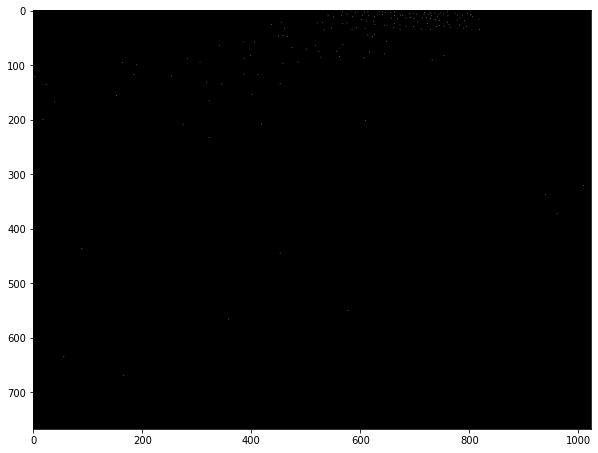

In [ ]:
# creating a blank background
ex_blank_zeros = np.zeros((ex_img.shape[0], ex_img.shape[1]), dtype=np.float32)

# create a for loop to set annotated points as 1 
for ex_x_coordinate, ex_y_coordinate in ex_coordinates:
    ex_x_coordinate = int(ex_x_coordinate)
    ex_y_coordinate = int(ex_y_coordinate)
    ex_blank_zeros[ex_y_coordinate, ex_x_coordinate] = 1
    
figure = plt.figure(figsize=(10,10))
plt.imshow(ex_blank_zeros,cmap="gray")

### 1.5 Visualization of density map 

Using the canvas and points plotted in the step above, we can apply a gaussian filter over it to better visualize the position of the heads.

Total crowd count is: 154


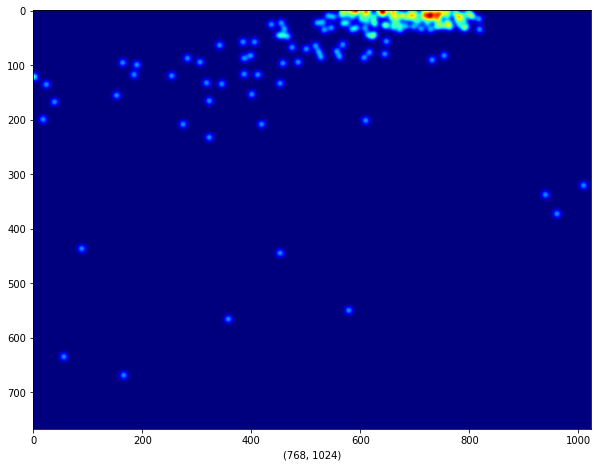

In [ ]:
ex_density_map = gaussian_filter(ex_blank_zeros,sigma=5,truncate=5*5)
ex_count = len(ex_coordinates)

figure = plt.figure(figsize=(10,10))
plt.xlabel(ex_density_map.shape)
plt.imshow(ex_density_map,cmap="jet")
print('Total crowd count is:', ex_count)

## **2. Loading Data** 

### 2.1 Set up the main path for training and test dataset

In [ ]:
# Assigning the training and testing paths
root = '/content/drive/MyDrive/Colab Notebooks/DL_Assignment/Shanghai_dataset/'

# Path for training and testing images
train_B_path = os.path.join(root,'part_B_final/train_data','images')
train_B_path = [train_B_path]
test_B_path = os.path.join(root,'part_B_final/test_data','images')
test_B_path = [test_B_path]

# Path for training and testing ground truth mat files 
train_GT_B_path = os.path.join(root,'part_B_final/train_data','ground_truth')
train_GT_B_path = [train_GT_B_path]
test_GT_B_path = os.path.join(root,'part_B_final/test_data','ground_truth')
test_GT_B_path = [test_GT_B_path]


### 2.2 Compiling all file paths of images and ground truth for training & testing dataset

For both the training and testing dataset there are two steps:

1. Append all the image and ground truth file paths into a list
2. Sort the file paths using tcl 



The sorting process is crucial as it ensures that the index of the list of file path for the image and ground truth refers to the same original image. Without this step, there will problems of using the wrong ground truth on the wrong image. 

In total the size of the dataset looks like this: 

* Training image/ground truth - 400
* Testing image/ground truth - 316

**Output = List of file paths** 

####2.2.1 Training Image Data

In [ ]:
train_b_list = []

# Loop and append all images in the file, joining all the test and train images into 1 
for path in train_B_path:
    for img_path in glob.glob(os.path.join(path, '*.jpg')):
        train_b_list.append(img_path)

# Print total number of images 
print("Total images : ",len(train_b_list))

Total images :  400


In [ ]:
# sort the files in the list 
train_b_list = Tcl().call('lsort', '-dict', train_b_list)

#### 2.2.2 Testing Image Data

In [ ]:
test_b_list = []

# Loop and append all images in the file, joining all the test and train images into 1 
for path in test_B_path:
    for img_path in glob.glob(os.path.join(path, '*.jpg')):
        test_b_list.append(img_path)

# Print total number of images 
print("Total images : ",len(test_b_list))

Total images :  316


In [ ]:
# sort the files in the list
test_b_list = Tcl().call('lsort', '-dict', test_b_list)

#### 2.2.3 Training ground truth dataset

In [ ]:
train_GT_b_list = []

# Loop and append all images in the file, joining all the test and train images into 1 
for path in train_GT_B_path:
    for gt_path in glob.glob(os.path.join(path, '*.mat')):
        train_GT_b_list.append(gt_path)

# Print total number of images 
print("Total mat files : ",len(train_GT_b_list))

Total mat files :  400


In [ ]:
# sort the files in the list
train_GT_b_list = Tcl().call('lsort', '-dict', train_GT_b_list)

#### 2.2.4 Testing ground truth dataset

In [ ]:
test_GT_b_list = []

# Loop and append all images in the file, joining all the test and train images into 1 
for path in test_GT_B_path:
    for gt_path in glob.glob(os.path.join(path, '*.mat')):
        test_GT_b_list.append(gt_path)

# Print total number of images 
print("Total mat files : ",len(test_GT_b_list))

Total mat files :  316


In [ ]:
# sort the files in the list
test_GT_b_list = Tcl().call('lsort', '-dict', test_GT_b_list)

### 2.2.5 Split Test dataset into Validation and Test 

As we only need a few images to test the prediction of the model, we will use part of this dataset to create a validation dataset instead of obtaining it from the training dataset.

In [ ]:
valid_img_list,test_img_list,valid_gt_list,test_gt_list = train_test_split(test_b_list,
                                                             test_GT_b_list, 
                                                             test_size=0.2, 
                                                             random_state=13)

Let us check the shape and size of the validation and testing dataset

In [ ]:
print("Validation image dataset:", np.shape(valid_img_list)[0])
print("Validation ground truth dataset:",np.shape(valid_gt_list)[0])

print("Testing image dataset:", np.shape(test_img_list)[0])
print("Testing ground truth dataset:",np.shape(test_gt_list)[0])

Validation image dataset: 252
Validation ground truth dataset: 252
Testing image dataset: 64
Testing ground truth dataset: 64


Checking if the index of the image file and ground truth is correct

In [ ]:
print(valid_img_list[100])
print(valid_gt_list[100])

/content/drive/MyDrive/Colab Notebooks/DL_Assignment/Shanghai_dataset/part_B_final/test_data/images/IMG_176.jpg
/content/drive/MyDrive/Colab Notebooks/DL_Assignment/Shanghai_dataset/part_B_final/test_data/ground_truth/GT_IMG_176.mat


## **3. Data Pre-processing**




In this segment we will create a function that can process both the input image and ground truth. 


---



**Input Images**


*   Convert BGR to RGB

When reading the images using cv2 imread, the images will be read in the form of BGR. Hence, we will need to convert it to RGB to obtain the original image.
*   Resize 

In this dataset, the images do not have a fixed size. To reduce the complexity of the model, the images are resized to 180x180. 

* Normalization

Normalization of the image is done to standardize the pixel values into the range of 0 to 1. This is done to stabilize the learning process as the values are closer to each other which will not result in drastic change in pixel values if not normalized (B, 2017). 

---
**Ground Truths** 

* Convert to Density Map using Gaussian Filter 

Using the ground truth provided in a form of x and y coordinates of the heads/points in the image, we will use Gaussian filter to display the annotated points in a form of a density map.
* Resize

The density map generated from the ground truth will be resized to 180x180 to match the size of the input images. 




### 3.1 Create function to process images and generate density map from dataset

Input - list of image file paths, list of ground truth mat file paths

Output - list of processed images in arrays, list of density map in arrays

In [ ]:
def get_processed_img_dm (img_list, gt_list):
  processed_img_list = []
  density_maps_list = []
  count = 0

  for i in range(0,len(img_list)):
    # 1. Processing for images
    # convert BGR to RGB 
    rgb_img = cv2.cvtColor(cv2.imread(img_list[i]),cv2.COLOR_BGR2RGB)
    # resize image 
    resized_img = cv2.resize(rgb_img,(180,180))
    # normalize data so that values are between 0 and 1 
    norm_img = resized_img/255
    # append processed images into list
    processed_img_list.append(norm_img)

    # 2. Generating density map 
    # extract the coordinate arrays only
    coor_info = io.loadmat(gt_list[i])["image_info"][0][0][0][0][0]
    # create blank canvas 
    canvas = np.zeros((rgb_img.shape[0], rgb_img.shape[1]), dtype=np.float32) 
    # plot coordinates on blank canvas
    for x_coor, y_coor in coor_info:
      if ( 0 <= x_coor <= rgb_img.shape[1]) and ( 0 <= y_coor <= rgb_img.shape[0]):
        x_coor = int(x_coor)
        y_coor = int(y_coor)
        canvas[y_coor, x_coor] = 1
    # generate density map using gaussian filter
    density_map = gaussian_filter(canvas, sigma=6, truncate=6*6)
    # resize density map to the same size as the image 
    resized_dm = cv2.resize(density_map,(180,180))
    # append generated density map into list
    density_maps_list.append(resized_dm)
    count+=1
    #print(count)

  # Convert the list to arrays 
  processed_img_array= np.array(processed_img_list, dtype ="float32")
  density_maps_array= np.array(density_maps_list, dtype ="float32")

  return processed_img_array, density_maps_array


### 3.2 Loading processed datasets

Get new processed images and density map using the function created above. 


In [ ]:
train_b_img, train_b_dm = get_processed_img_dm(train_b_list, train_GT_b_list)
valid_img, valid_dm = get_processed_img_dm(valid_img_list, valid_gt_list)
test_img, test_dm = get_processed_img_dm(test_img_list, test_gt_list)

### 3.3 Testing out the data processing function on a sample set

In [ ]:
# Taking few images and ground truth data for this test
test_list = train_b_list[5:10]
test_gt_list = train_GT_b_list[5:10]
np.shape(test_list)[0]

5

In [ ]:
# applying the function 
new_img, new_dm = get_processed_img_dm(test_list,test_gt_list)

As we can see, both the new image and density map are in 180x180 

In [ ]:
# check shape of new processed image
np.shape(new_img)

(5, 180, 180, 3)

In [ ]:
# check shape of density map 
np.shape(new_dm)

(5, 180, 180)

Visualization of the new processed image 

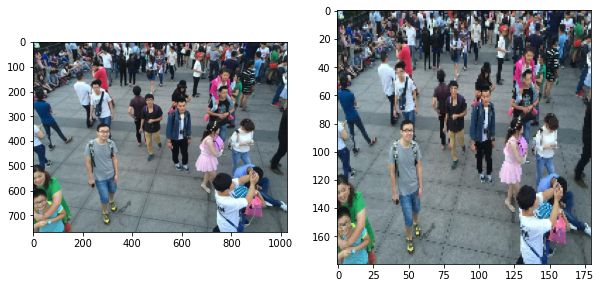

In [ ]:
old_img = plt.imread(train_b_list[7])
new_img1 = new_img[2]
figure, axis = plt.subplots(1,2,figsize=(10,10))

axis[0].imshow(old_img)
axis[1].imshow(new_img1)


Left: Old image, Right: New processed image 

As we can see in the display above, the new procssed image is slightly more blur due to the normalization but the heads can still be clearly seen. Additionally, the shaped of the image is also changed to a 180x180 square 

Visualize the density map generated

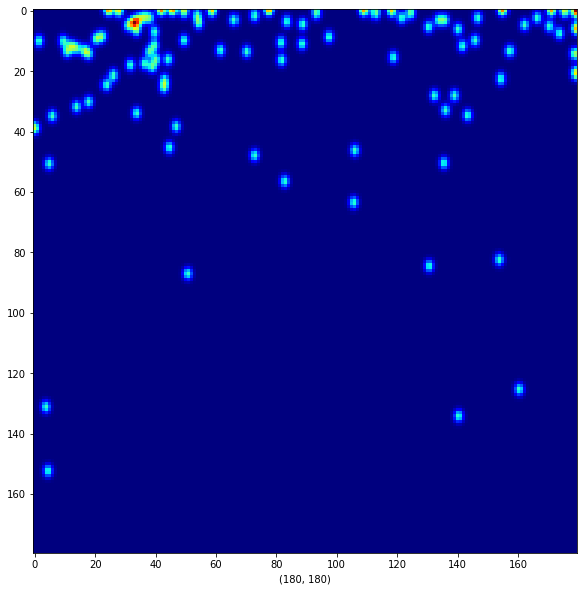

In [ ]:
figure = plt.figure(figsize=(10,10))
plt.xlabel(new_dm[2].shape)
plt.imshow(new_dm[2],cmap="jet")

## **4. Autoencoder Modeling** 

There are mainly two types of autoencoder which is the Simple Autoencoder (SAE) and Deep CNN Autoencoder. The main difference between these two types of autoencoder is that the SAE is based on a fully connected neural layer while the Deep CNN version uses convolution layers. In this assignment we have decided to use a Deep CNN based autoencoder as it involves a more complicated dataset which would required deeper learning.

An autoencoder is a generative model which encodes the input into feature vectors in a latent space and then decodes it to reconstruct the data which should be a close replica of the original input data.

In the case of crowd estimation, the autoencoder will accept the original images as input and reconstruct a "new" image which will then be compared to the density map generated from the ground truth. 
 

### 4.1 Set model hyperparameters

To begin with the modeling we will first set the model hyperparameters such as the type of loss, type of optimizer and the learning rate of the optimizer. As we are building an end-to-end regression model using the Deep CNN Autoencoder the loss of the model will be calculated using the mean squared error. 

According to a comparison of optimizers by Mack (2018), the Adam optimizer performed the best in terms of learning speed and was also one of the more stable optimizers in terms of performance in accuracy. Unlike traditional stochastic gradient descent which maintains the same learning rate for the entire training period, Adam is an adaptive gradient descent algorithm which can adapt different learning rates as the learning unfolds (Brownlee, 2017). The range of learning rate which will be adapted during the training of the model can vary depending on the configuration of the parameters such as the alpha, beta and epilson. However, we will not go too deep into that and remain the default values while changing the main learning rate value where the optimizer will begin and adapt with. 

There is no universal best learning rate for all types of model as it varies according to the complexity of the model. In this assignment we will try two different values of learning rate to see which would best fit our model. However, obtaining the optimal learning rate is a very tricky task. A learning rate that is too small will result in long training time and slow convergence (Pavel Surmenok, 2017). On the other hand, a learning rate that is too high may results in overshooting and missing the minimum. Thus, we will use this opportunity to try different learning rates while maintaining the same network architecture when training the model.


In [ ]:
# Model 1
compile_loss = "mse"
compile_optimizer = Adam(learning_rate=0.001)
output_class = 1

In [ ]:
# Model 2 
compile_loss = "mse"
compile_optimizer = Adam(learning_rate=0.000001)
output_class = 1

### 4.2 Build Encoder

In this assignment we will stick to fairly basic and simple network archicture which consists of 4 layers, each with one 2D convolution layer with kernel size of 2x2 and is initialized using 'he_normal' where samples are obtained from a truncated normal distribution centered on 0 with stddev = sqrt(2 / fan_in) where fan_in is the number of input units in the weight tensor (TensorFlow, 2021)

Each convolution layer is then followed with a batch normalization. Although normalization is done on the input image, it only impacts the first input layer. Using batch normalization before the activation function can help standardize the input data each time it is fed into the next layer for each mini batch (B, 2017). 

Following each batch normalization, the ReLu (Rectified Linear Unit) Layer is used as the activation function of the model. 

In [ ]:
# Initialize sequential model 
Encoder = keras.models.Sequential()
# Layer 1
Encoder.add(Conv2D(32,(2,2),kernel_initializer = 'he_normal'))
Encoder.add(BatchNormalization())
Encoder.add(ReLU())
# Layer 2
Encoder.add(Conv2D(64,(2,2),kernel_initializer = 'he_normal'))
Encoder.add(BatchNormalization())
Encoder.add(ReLU())
# Layer 3
Encoder.add(Conv2D(128,(2,2),kernel_initializer = 'he_normal'))
Encoder.add(BatchNormalization())
Encoder.add(ReLU())
# Layer 4
Encoder.add(Conv2D(256,(2,2),kernel_initializer = 'he_normal'))
Encoder.add(BatchNormalization())
Encoder.add(ReLU())

### 4.3 Build Decoder

As for the decoder, 2D transpose convolution layers are used to upsample the input feature map from the previous layer which is part of the image reconstruction process.

In [ ]:
Decoder = Sequential()
# Layer 1
Decoder.add(Conv2DTranspose(128,(2,2)))
Decoder.add(ReLU())
# Layer 2
Decoder.add(Conv2DTranspose(64,(2,2)))
Decoder.add(ReLU())
# Layer 3
Decoder.add(Conv2DTranspose(32,(2,2)))
Decoder.add(ReLU())
# layer 4
Decoder.add(Conv2DTranspose(output_class,(2,2)))
Decoder.add(ReLU())

### 4.4 Compiling the Autoencoder (Encoder + Decoder)

After building the encoder and decoder segments, we can combine both together to build the autoencoder and compile it with the hyperparameters to build the architecture of the model. 

In [ ]:
Auto_Encoder = Sequential([Encoder,Decoder])
Auto_Encoder.compile(loss=compile_loss,optimizer=compile_optimizer)

### 4.5 Tensorboard callback 

In order to display the changes in loss in each epoch during training on the tensorboard, we first need to set a log file directory and callback function.

In [ ]:
import datetime
from tensorflow.keras.callbacks import TensorBoard

In [ ]:
# Load tensorboard
%load_ext tensorboard

In [ ]:
logdir = "logs/scalars/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

## **5. Traning Autoencoder**

In this segment we will train 2 models using different learning rates at 0.001 and 0.000001. These values are manually picked to showcase a more drastic different in performance using two different rates. 

Both models will be trained with batch size of 30 and 5 epochs and 10 steps per epoch. 

In [ ]:
# clear any existing logs for the tensorboard
!rm -rf /logs/

### 5.1 Model 1 ( Adam - Learning rate = 0.001)

In this first model we will be using a default Adam learning rate in tensorflow. In comparison to the other learning rate that we will use for the second model, 0.001 would be considered as the faster learning rate among the two.  

In [ ]:
AE_defaultadamlr = Auto_Encoder.fit(train_b_img, train_b_dm ,validation_data=(valid_img, valid_dm),epochs=5,steps_per_epoch=10, callbacks = tensorboard_callback, batch_size= 30)

Epoch 1/5
10/10 [==============================] - 506s 51s/step - loss: 2.1855e-05 - val_loss: 6.8567e-07
Epoch 2/5
10/10 [==============================] - 521s 53s/step - loss: 6.1247e-07 - val_loss: 6.8488e-07
Epoch 3/5
10/10 [==============================] - 473s 48s/step - loss: 7.5527e-07 - val_loss: 6.8488e-07
Epoch 4/5
10/10 [==============================] - 547s 56s/step - loss: 7.1339e-07 - val_loss: 6.8488e-07
Epoch 5/5
10/10 [==============================] - 520s 53s/step - loss: 6.9084e-07 - val_loss: 6.8488e-07


In [ ]:
%tensorboard --logdir logs/scalars

Reusing TensorBoard on port 6006 (pid 2563), started 1:21:00 ago. (Use '!kill 2563' to kill it.)

<IPython.core.display.Javascript object>

### 5.2 Model 2 ( Learning rate - 0.000001)

In this second model we decided to opt for a much lower learning rate to see how this difference will affect the training.

In [ ]:
%tensorboard --logdir logs/scalars

<IPython.core.display.Javascript object>

In [ ]:
AE_defaultadamlr = Auto_Encoder.fit(train_b_img, train_b_dm ,validation_data=(valid_img, valid_dm),epochs=5,steps_per_epoch=10, callbacks = tensorboard_callback, batch_size= 30)

Epoch 1/5
10/10 [==============================] - 550s 56s/step - loss: 0.1950 - val_loss: 0.0053
Epoch 2/5
10/10 [==============================] - 473s 48s/step - loss: 0.1818 - val_loss: 0.0051
Epoch 3/5
10/10 [==============================] - 473s 48s/step - loss: 0.1692 - val_loss: 0.0060
Epoch 4/5
10/10 [==============================] - 548s 56s/step - loss: 0.1578 - val_loss: 0.0073
Epoch 5/5
10/10 [==============================] - 521s 53s/step - loss: 0.1473 - val_loss: 0.0088


In [ ]:
Auto_Encoder.save('/content/drive/MyDrive/Colab Notebooks/DL_Assignment/saved_models/AE30b_5_10epoch_adam_defaultlr.h5')

#### **Comments**

As we can see in the epoch loss graph for Model 1 using the larger learning rate, there is greater change in loss especially at the 2nd epoch. In comparison to the epoch loss graph for Model 2 using a much smaller learning rate, the variation in loss of epoch is much smaller. These results corresponds to the speed of learning rate where higher learning rate will take bigger steps which can results in more drastic change in loss while smaller learning rates take smaller steps and have a more stable change in loss. 

Although the general rule is that the smaller the loss the better the model, in this case we can see that both models resulted in validation loss that are lower than the training loss itself. This may be due to various factors however the most possible reason may be due to the lack of training as it is only trained on 5 epochs with 10 steps each. Due to a long training time needed, this assignment decided to go for smaller epoch size. However, this lack of training resulted in both models not being able to reach convergence within the training period. Therefore, more training will be required in order to improve the performance of the model. 

##**6. Prediction**

In this segment we will use the trained model to predict the estimated crowd on an unseen image.

### 6.1 Prediction 1 (lr = 0.000001)

In [ ]:
# link to the saved model 1 
https://drive.google.com/file/d/1v9ukSCs0gvaobImQ2zv_NkpmC4UJs_S5/view?usp=sharing

In [ ]:
model1 = load_model('/content/drive/MyDrive/Colab Notebooks/DL_Assignment/saved_models/AE30b_5_10epoch_adam_lowlr.h5')

In [ ]:
# actual count of crowd in image
testdm2 = io.loadmat(test_gt_list[3])["image_info"][0][0][0][0][0]
count = np.shape(testdm2)[0]
print("Actual count is:", count)

Actual count is: 24


In [ ]:
# reshaping the testing image to fit the required input shape 
test2 = test_img[3].reshape(-1,180,180,3)

In [ ]:
# get the predicted results 
pred4 = model1.predict(test2)
count = np.sum(pred4)
print("Predicted count is:", count)

# reshaping the predicted output in order to print it out as density map in the following step 
pred4 = pred4.reshape(180,180)

Predicted count is: 3088.5


Text(0.5, 1.0, 'Predicted Density Map')

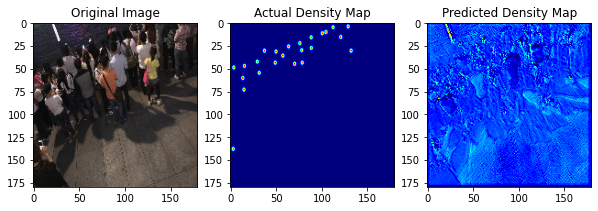

In [ ]:
figure,axis = plt.subplots(1,3,figsize=(10,10))
axis[0].imshow(test_img[3])
axis[0].set_title("Original Image")
axis[1].imshow(test_dm[3],cmap="jet")
axis[1].set_title("Actual Density Map")
axis[2].imshow(pred4,cmap="jet")
axis[2].set_title("Predicted Density Map")

**Comments**

Looking at the predicted density map and estimated count from model 1, the trained model can be considered as overfitted as it captures too much details which ends up being noise in this scenario where we mainly want to detect the highest point of the heads. However, this problem may be easily fixed with more training time to allow the model to learn deeper features.   

In this example below, we actually trained another model with the same learning rate at 20 epochs and the predicted density map appears significantly better with less noise.

Text(0.5, 1.0, 'Predicted Density Map')

Exception ignored in: <function IteratorResourceDeleter.__del__ at 0x7f1e4d8afb00>
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/iterator_ops.py", line 546, in __del__
    handle=self._handle, deleter=self._deleter)
  File "/usr/local/lib/python3.7/dist-packages/tensorflow/python/ops/gen_dataset_ops.py", line 1264, in delete_iterator
    _ctx, "DeleteIterator", name, handle, deleter)
KeyboardInterrupt: 


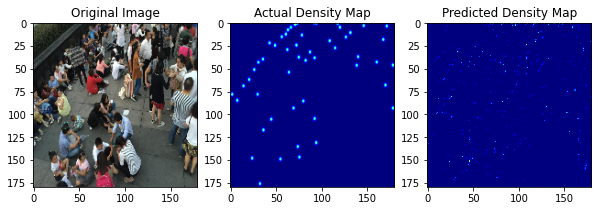

In [ ]:
figure,axis = plt.subplots(1,3,figsize=(10,10))
axis[0].imshow(test_b_imgA[1])
axis[0].set_title("Original Image")
axis[1].imshow(test_b_dmA[1],cmap="jet")
axis[1].set_title("Actual Density Map")
axis[2].imshow(pred1,cmap="jet")
axis[2].set_title("Predicted Density Map")

### 6.2 Prediction 2 (lr = 0.001 (default in tensorflow))

In [ ]:
# link to the saved model 2 
https://drive.google.com/file/d/1-0KZKD-cBs6f9Uko7NvaFYiepVJm6m6U/view?usp=sharing

In [ ]:
model2 = load_model('/content/drive/MyDrive/Colab Notebooks/DL_Assignment/saved_models/AE30b_5_10epoch_adam_defaultlr.h5')

In [ ]:
# actual count 
testdm2 = io.loadmat(test_gt_list[3])["image_info"][0][0][0][0][0]
count = np.shape(testdm2)[0]
print(count)

24


In [ ]:
test2 = test_img[3].reshape(-1,180,180,3)

In [ ]:
pred4 = model2.predict(test2)
count = np.sum(pred4)
print(count)

pred4 = pred4.reshape(180,180)

0.0


Text(0.5, 1.0, 'Predicted Density Map')

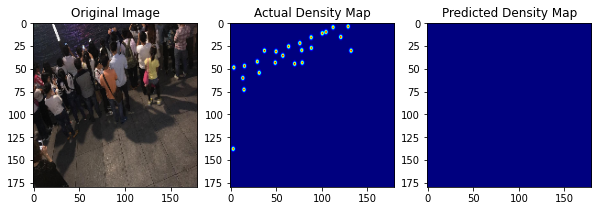

In [ ]:
figure,axis = plt.subplots(1,3,figsize=(10,10))
axis[0].imshow(test_img[3])
axis[0].set_title("Original Image")
axis[1].imshow(test_dm[3],cmap="jet")
axis[1].set_title("Actual Density Map")
axis[2].imshow(pred4,cmap="jet")
axis[2].set_title("Predicted Density Map")

**Comments**

In the 2nd model trained, we can see a complete opposite results in comparison to the first model where the predicted density map was too noisy. The predicted density map using model 2 shows a completely blank space which may indicate that the model is severely underfitted. As the predicted density map does not have any points,the loss between the actual and predicted became extremely small. Thus, when comparing the loss and validation loss between the two models, this model had a drastically smaller loss in comparison. 

## **Conclusion**

In conclusion we have trained and tested two Deep CNN Autoencoders on the ShanghaiTech B dataset which mainly contains sparse to averagely dense crowds. Each model was built using different learning rates such as 0.001 and 0.000001 where the first represents a faster learning rate and the latter is slower. Through this experiment we witnessed the affect of different learning rates and the importance of choosing the right learning rate when training a model. Additionally, other factors such as training time also plays a crucial part in allowing the models to learn deeper models in order to improve the performance of the model. Although we did not obtain optimal results with the two models we have built in this assignment, we can still conclude that learning rate does have an impact on the model. In future work, a learning rate scheduler can be useful to determine the most optimal learning rate for the model rather than using manual trial and error. 


# **References**

B, N. (2017). Image Data Pre-Processing for Neural Networks. [online] Medium. Available at: https://becominghuman.ai/image-data-pre-processing-for-neural-networks-498289068258 [Accessed 5 Sep. 2021].

Brownlee, J. (2017). Gentle Introduction to the Adam Optimization Algorithm for Deep Learning. [online] Machine Learning Mastery. Available at: https://machinelearningmastery.com/adam-optimization-algorithm-for-deep-learning/ [Accessed 2 Sep. 2021].

Dai, Z. and Heckel, R. (2019). Channel Normalization in Convolutional Neural Networks avoids Vanishing Gradients. [online] Available at: https://openreview.net/pdf?id=rJxBv4r22V [Accessed 2 Sep. 2021].

Mack, D. (2018). How to pick the best learning rate for your machine learning project. [online] www.freecodecamp.org. Available at: https://www.freecodecamp.org/news/how-to-pick-the-best-learning-rate-for-your-machine-learning-project-9c28865039a8/.

Pavel Surmenok (2017). Estimating an Optimal Learning Rate For a Deep Neural Network. [online] Medium. Available at: https://towardsdatascience.com/estimating-optimal-learning-rate-for-a-deep-neural-network-ce32f2556ce0.

TensorFlow. (2021). tf.keras.initializers.HeNormal | TensorFlow Core v2.6.0. [online] Available at: https://www.tensorflow.org/api_docs/python/tf/keras/initializers/HeNormal [Accessed 5 Sep. 2021].

In [ ]:
%%shell
jupyter nbconvert --to html /content/Crowd_Estimation_using_Autoencoder2.ipynb

[NbConvertApp] Converting notebook /content/Crowd_Estimation_using_Autoencoder2.ipynb to html
[NbConvertApp] Writing 2278289 bytes to /content/Crowd_Estimation_using_Autoencoder2.html
